# Downsample block tests

This notebook is for test different internal structures for a downsample layer in an U-net. The goal is to adjust the network input (the single embedding vector of an embedding layer) and the network weights to match the output of the network to a target feature map.

In [1]:
import tensorflow as tf
import os
import logging
logging.getLogger("tensorflow").setLevel(logging.ERROR)
tf.autograph.set_verbosity(0)
import time
from matplotlib import pyplot as plt
from matplotlib.image import imread
from IPython import display
import numpy as np
from PIL import Image, ImageDraw
import glob
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
#tf.compat.v1.disable_eager_execution()

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 10150376206410614726
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 4986830848
locality {
  bus_id: 1
  links {
  }
}
incarnation: 11070790042766985311
physical_device_desc: "device: 0, name: NVIDIA GeForce GTX 1660 Ti, pci bus id: 0000:01:00.0, compute capability: 7.5"
]


## Enable saving to Google Drive if working with colab, to external SSD, or disable if saving locally

In [2]:
def save_to(save = "locally"):
  if save == "colab":
    from google.colab import drive
    drive.mount('/content/drive')
    %cd drive/MyDrive/Colab Notebooks/drones
  elif save == "ssd":
    os.chdir("D:/GanNoMask")

save_to("ssd")

In [3]:
def load(image_file):
  image = tf.io.read_file(image_file)
  image = tf.io.decode_png(image)
  w = tf.shape(image)[1]
  real_image = image[:, :w, :]
  real_image = tf.cast(real_image, tf.float32)
  return real_image

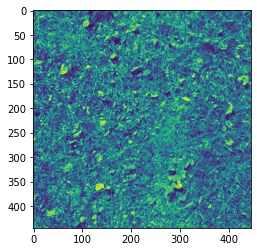

In [4]:
re = load("testtarget.png") / 255
plt.figure()
plt.imshow(re)

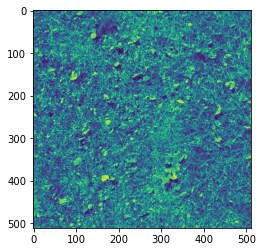

In [5]:
inp = load("testinput.png") / 255
plt.figure()
plt.imshow(inp)

## Constants
Batch size is 1 for these tests, because the goal is to match the network output to a single feature map. Image width and height must be sufficiently large to provide a good statistical sample over the spatial plane. The convolutions will somewhat reduce the network output spatial size due to 'valid' padding. The network is hard-coded to have 1 input channel and 2 output channels.

In [6]:
BATCH_SIZE = 1
IMG_WIDTH = 511
IMG_HEIGHT = 511

## Isotropic low-pass anti-aliasing filter
To ensure that the network operation is not affected by the image axis orientations, and that the network operation is unaffected by sub-pixel shifts, an isotropic anti-aliasing filter is used with horizontal and vertical frequency domain overhead defined by an oversampling factor.

See: https://dsp.stackexchange.com/questions/58301/2-d-circularly-symmetric-low-pass-filter for the filter kernel calculation and https://dsp.stackexchange.com/questions/58226/auto-detection-of-rotation-angle-on-arbitrary-image-with-orthogonal-features/58287#58287 for the window function calculation.


In [7]:
oversampling = 2  # Oversampling factor, 2 is a good choice
kernelN = 9  # Horizontal size of the kernel, also its vertical size. Must be odd. 9 is a good choice when oversampling == 2.

from scipy import special

def circularLowpassKernel(omega_c, N):  # omega = cutoff frequency in radians (pi is max), N = horizontal size of the kernel, also its vertical size, must be odd.
  kernel = np.fromfunction(lambda x, y: omega_c*special.j1(omega_c*np.sqrt((x - (N - 1)/2)**2 + (y - (N - 1)/2)**2))/(2*np.pi*np.sqrt((x - (N - 1)/2)**2 + (y - (N - 1)/2)**2)), [N, N])
  kernel[(N - 1)//2, (N - 1)//2] = omega_c**2/(4*np.pi)
  return kernel 

def rotatedCosineWindow(N):  # N = horizontal size of the targeted kernel, also its vertical size, must be odd.
  return np.fromfunction(lambda y, x: np.maximum(np.cos(np.pi/2*np.sqrt(((x - (N - 1)/2)/((N - 1)/2 + 1))**2 + ((y - (N - 1)/2)/((N - 1)/2 + 1))**2)), 0), [N, N])

window = rotatedCosineWindow(kernelN)

kernel_cutoff_pi = circularLowpassKernel(np.pi/oversampling, kernelN)
kernel_cutoff_minipi = circularLowpassKernel(0.95 * np.pi/oversampling, kernelN)

windowedkernel_cutoff_minipi = kernel_cutoff_minipi*window
windowedkernel_cutoff_minipi /= np.sum(windowedkernel_cutoff_minipi, axis=(0, 1)) # Normalize to sum = 1
windowedkernel_cutoff_minipi = windowedkernel_cutoff_minipi.astype(np.float32)


windowedkernel_cutoff_pi = kernel_cutoff_pi*window
windowedkernel_cutoff_pi /= np.sum(windowedkernel_cutoff_pi, axis=(0, 1)) # Normalize to sum = 1
windowedkernel_cutoff_pi = windowedkernel_cutoff_pi.astype(np.float32)

#Divide by zero warnings are OK

C:\ProgramData\Miniconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in true_divide
  import sys


In [8]:
expansion_kernel = np.array([[0, 0, 0], [0, 1, 0], [0, 0, 0]]).astype("float32")

Plot the anti-aliasing filter kernel and frequency response:

Kernel:


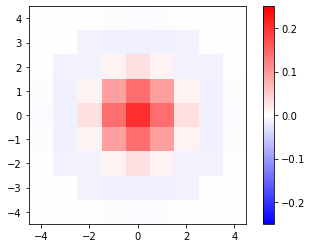

Frequency response:


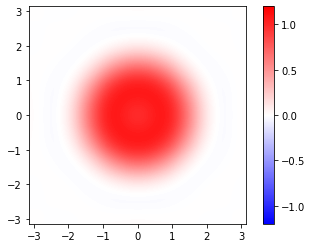

Kernel:


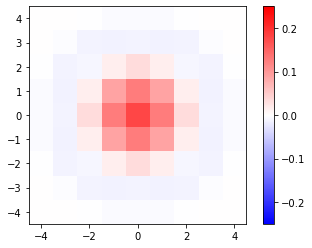

Frequency response:


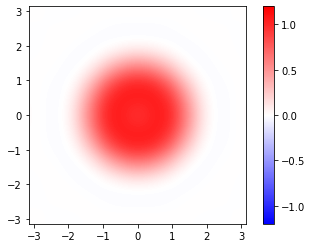

In [9]:
print("Kernel:")
plt.imshow(windowedkernel_cutoff_pi, vmin=-0.25, vmax=0.25, cmap='bwr', extent=[-kernelN/2, kernelN/2, -kernelN/2, kernelN/2])
plt.colorbar()
plt.show()

print("Frequency response:")
freq_resp = np.real(np.fft.fftshift(np.fft.fft2(np.roll(np.pad(windowedkernel_cutoff_pi, 100, mode = 'constant', constant_values = 0), shift = (-kernelN//2-99, -kernelN//2-99), axis = (0, 1)))))
plt.imshow(freq_resp, vmin=-1.2, vmax=1.2, cmap='bwr', extent=[-np.pi, np.pi, -np.pi, np.pi])
plt.colorbar()
plt.show()

print("Kernel:")
plt.imshow(windowedkernel_cutoff_minipi, vmin=-0.25, vmax=0.25, cmap='bwr', extent=[-kernelN/2, kernelN/2, -kernelN/2, kernelN/2])
plt.colorbar()
plt.show()

print("Frequency response:")
freq_resp = np.real(np.fft.fftshift(np.fft.fft2(np.roll(np.pad(windowedkernel_cutoff_minipi, 100, mode = 'constant', constant_values = 0), shift = (-kernelN//2-99, -kernelN//2-99), axis = (0, 1)))))
plt.imshow(freq_resp, vmin=-1.2, vmax=1.2, cmap='bwr', extent=[-np.pi, np.pi, -np.pi, np.pi])
plt.colorbar()
plt.show()

#plt.plot(freq_resp[100])

# Network definition and network and target noise initialization

Initialize the network input, the network structure, the network, and target noise which is white noise with frequency-domain overhead as dictated by the oversampling factor (defined earlier):

tf.Tensor(
[[[0.21568628]
  [0.47843137]
  [0.41568628]
  ...
  [0.4117647 ]
  [0.5294118 ]
  [0.42352942]]

 [[0.5529412 ]
  [0.28235295]
  [0.4862745 ]
  ...
  [0.3764706 ]
  [0.5411765 ]
  [0.3764706 ]]

 [[0.73333335]
  [0.50980395]
  [0.44313726]
  ...
  [0.34117648]
  [0.22745098]
  [0.3137255 ]]

 ...

 [[0.39607844]
  [0.35686275]
  [0.7176471 ]
  ...
  [0.21960784]
  [0.21960784]
  [0.23529412]]

 [[0.3137255 ]
  [0.4117647 ]
  [0.5529412 ]
  ...
  [0.0627451 ]
  [0.0627451 ]
  [0.05098039]]

 [[0.56078434]
  [0.7254902 ]
  [0.654902  ]
  ...
  [0.39215687]
  [0.30980393]
  [0.28627452]]], shape=(511, 511, 1), dtype=float32)


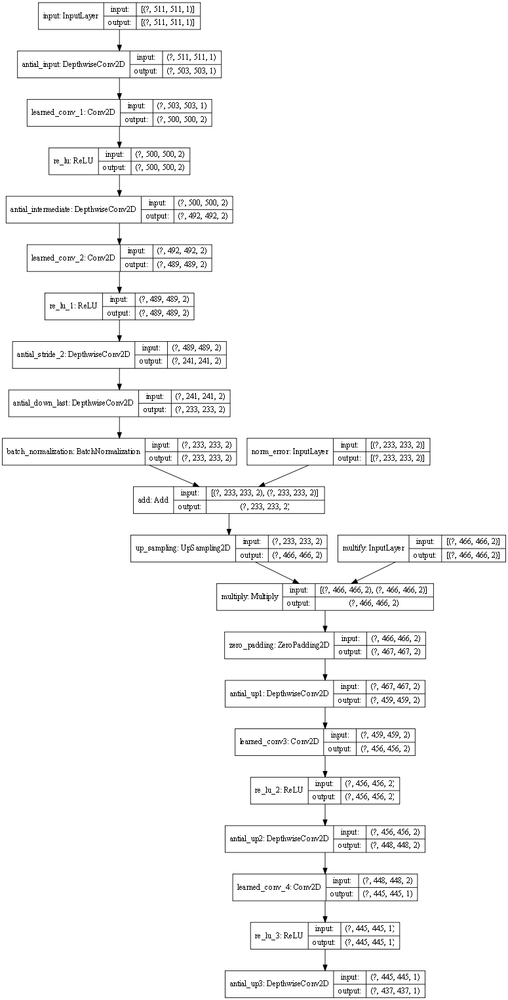

In [15]:
# Initialize an anti-aliasing layer
def init_antial(layer, kernel, expansion = False):
  reps = np.shape(layer.get_weights())[3]
  new_w = tf.repeat(tf.constant([[kernel]]), reps, axis = 3)
  new_w = tf.reshape(new_w, [kernel.shape[0], kernel.shape[1], reps, 1])
  if expansion:
    new_w = tf.repeat(tf.constant([[kernel]]), 4, axis = 3)
    new_w = tf.reshape(new_w, [3, 3, 2, 2])
  layer.set_weights([new_w])
  layer.trainable = False
  
# Define the multiplication layer for the unet
def multiply_layer():
  two_row_root = tf.constant([[0, 0], [0, 4]])
  almost_shape = tf.tile(two_row_root, [233, 233])
  shape = tf.repeat(tf.expand_dims(almost_shape, axis = -1), 1, axis = -1)
  shape = tf.cast(shape, "float32")
  shape = tf.expand_dims(shape, axis = 0)
  return shape

multiply_layer = multiply_layer()

def Model():  
  z = tf.keras.Input(shape = (511, 511, 1), name = "input")
  multify = tf.keras.Input(shape = (466, 466, 2), name = "multify")
  error = tf.keras.Input(shape = (233, 233, 2), name = "norm_error")
  
  y = multify

  x = z
  
  noisy = error

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_input")(x)

  # -------- downsample start ---------

  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1), use_bias=True, name = "learned_conv_1")(x)

  x = tf.keras.layers.ReLU()(x)
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_intermediate")(x)

  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1), use_bias=True, name = "learned_conv_2")(x)
  # Note that ReLu limits the output to non-negative values, so the target needs to be non-negative with isotropic filtering applied

  x = tf.keras.layers.ReLU()(x)
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=2, padding='valid', use_bias=False, name = "antial_stride_2")(x) # First, stride 2 anti-aliasing filter

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_down_last")(x) # Then, restore frequency-domain overhead

  # -------- downsample ends ---------
  
  # Normalize and add some noise
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.add([x, noisy])
  
  # -------- upsample starts ---------

  # 1. zero stuffing

  x = tf.keras.layers.UpSampling2D(size = (2, 2), name = "up_sampling")(x)
  
  x = tf.keras.layers.multiply([x, y])
  
  x = tf.keras.layers.ZeroPadding2D(padding = ((0, 1), (0, 1)), name = "zero_padding")(x)
  
  # 2. anti-aliasing (change cutoff here to a bit lower here!)
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_up1")(x)
  
  # 3. conv2d learned 1, relu
  
  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1), use_bias=True, name = "learned_conv3")(x)
  
  x = tf.keras.layers.ReLU()(x)

  # 4. anti-aliasing
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_up2")(x)

  
  # 5. conv2d learned 2, relu
  
  x = tf.keras.layers.Conv2D(1, 4, strides=1, padding='valid', kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1), use_bias=True, name = "learned_conv_4")(x)
  
  x = tf.keras.layers.ReLU()(x)

  # 6. anti-aliasing
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_up3")(x)

  # ---------- upsample ends ----------

  model = tf.keras.Model(inputs=[z, multify, error], outputs=x)

  init_antial(model.get_layer('antial_input'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_intermediate'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_stride_2'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_down_last'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_up1'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_up2'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_up3'), windowedkernel_cutoff_pi)  

  return model

model = Model()

def filter_target(noise, kernel):
  reps = tf.shape(noise)[-1]
  channeled_kernel = tf.repeat(kernel, reps)
  noise = tf.nn.depthwise_conv2d(noise, tf.reshape(channeled_kernel, (kernel.shape[0], kernel.shape[1], reps, 1)), [1, 1, 1, 1], padding = "VALID")
  return noise

def random_noise(batch_size, img_width, img_height, channels): ## Some random noise to prevent the model's cheating
    noise_vector = tf.random.uniform([batch_size, img_width, img_height, channels], minval = 1e-6, maxval = 9e-6) # Uniform between 0 and 1
    return noise_vector

# Initialize random noise input
z = inp

error = random_noise(1, 233, 233, 2)

print(z)

z = tf.expand_dims(z, axis = 0)

target = tf.expand_dims(re, axis = 0)

target = filter_target(target, windowedkernel_cutoff_pi)

tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)

## Testing whether the multiplication works as intended

In [ ]:
aaa = random_noise(1, 233, 233, 1)
aaa = tf.keras.layers.UpSampling2D(size = (2, 2))(aaa)
aaa = tf.keras.layers.multiply([aaa, multiply_layer])
aaa = tf.keras.layers.ZeroPadding2D(padding = ((0 , 1), (0, 1)))(aaa)
aaa[0]

## Define loss and optimizer

L2 loss is used. Adam optimizer is used.

In [16]:
def model_loss(gen_output, target):

  l2_loss = tf.reduce_mean((target - gen_output)**2)

  return l2_loss

def select_optimizer():
  #optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5, beta_2=0.99, epsilon=1e-07)
  optimizer = tf.keras.optimizers.Adam()
  return optimizer

optimizer = select_optimizer()

## Image saving, training step, and fit function
Save losses to TensorBoard, show and save network output and show some basic stats every `save_every` epochs. Save trained network when fitting is finished, after `epochs` epochs.

In [17]:
save_every = 100 # How many epochs to skip between data display and saving

def generate_images(model, z, multiply_layer, target, save = False, epoch = 0, training = False): # the training parameter is for batchnorm, in case it is used
  error = random_noise(1, 233, 233, 2)
  prediction = model([z, multiply_layer, error], training=training)
  plt.figure(figsize=(10, 10))
  # red = channel 0, green = channel 1, blue = channel 0
  first = prediction[0, ...]
  second = target[0, ...]
  display_list = [first, second]
  title = ['Network output', 'Target']
  
  if save:
    name = str(epoch).zfill(4)
    tf.keras.preprocessing.image.save_img((im_dir + str(name) + ".png"), first)

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()
  
@tf.function
def train_step(z, multiply_layer, target, epoch):
  with tf.GradientTape() as tape:
    error = random_noise(1, 233, 233, 2)
    gen_output = model([z, multiply_layer, error], training=True)
    loss = model_loss(gen_output, target)
    
  gradients = tape.gradient(loss, model.trainable_variables)
  
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  
  with summary_writer.as_default():
    tf.summary.scalar('model_loss', loss, step=epoch)

def fit(epochs):
  for epoch in range(epochs + 1):
    
    # Train
    start = time.time()
    if epoch > 0:
      train_step(z, multiply_layer, target, epoch)
    elapsed = time.time() - start
    if epoch % save_every == 0 or epoch == epochs:
      #display.clear_output(wait=True)
      generate_images(model, z, multiply_layer, target, save = True) #training = ?
      if epoch == 0:
        print("Before fitting")
      else:
        print('Training epoch {}, took {} s\n'.format(epoch, elapsed))
      print("Loss: " + str(tf.keras.backend.get_value(model_loss(model([z, multiply_layer, error], training=True), target))))
      print("RMS deviance: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.reduce_mean((target - model([z, multiply_layer, error], training=True))**2)))))
      print("Learned Min: " + str(tf.keras.backend.get_value(tf.math.reduce_min(model.get_layer('learned_conv_1').get_weights()[0]))))
      print("Learned RMS: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.math.reduce_mean(model.get_layer('learned_conv_1').get_weights()[0]**2)))))
      print("Learned Max: " + str(tf.keras.backend.get_value(tf.math.reduce_max(model.get_layer('learned_conv_1').get_weights()[0]))))
    
  checkpoint.save(file_prefix=checkpoint_prefix)

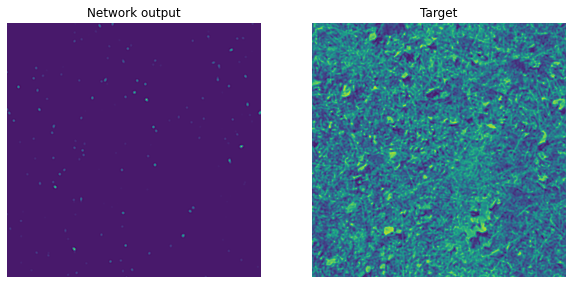

In [18]:
generate_images(model, z, multiply_layer, target)

## Initiate image and log dirs and TensorBoard

In [20]:
checkpoint_dir = './training_checkpoints_downup'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(model=model)
checkpoint.save(file_prefix=checkpoint_prefix)

def checkpoint_save(epoch, inEpochs = 30):
  if (epoch + 1) % inEpochs == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

import datetime
log_dir = "logs/"
im_dir = "images/fit" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "/"
os.makedirs(im_dir)
summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [22]:
%reload_ext tensorboard
%tensorboard --logdir {log_dir} --host localhost --port 6274

Reusing TensorBoard on port 6274 (pid 15012), started 0:01:04 ago. (Use '!kill 15012' to kill it.)

## Fit the model

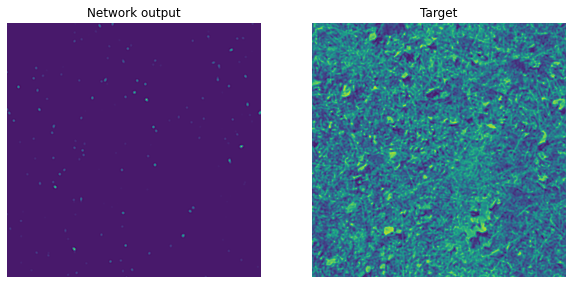

Before fitting
Loss: 0.18139023
RMS deviance: 0.42589933
Learned Min: -0.9078109
Learned RMS: 0.48887855
Learned Max: 0.9212351


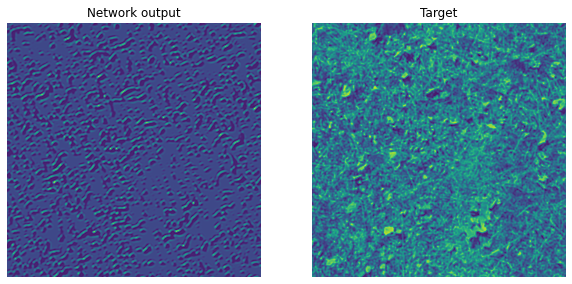

Training epoch 100, took 0.29103636741638184 s

Loss: 0.11663084
RMS deviance: 0.34151256
Learned Min: -0.8817386
Learned RMS: 0.48687783
Learned Max: 0.92741555


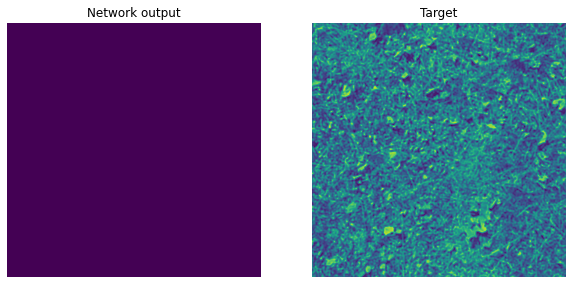

Training epoch 200, took 0.30140185356140137 s

Loss: 0.06237767
RMS deviance: 0.24975522
Learned Min: -0.9125191
Learned RMS: 0.48499507
Learned Max: 0.93088245


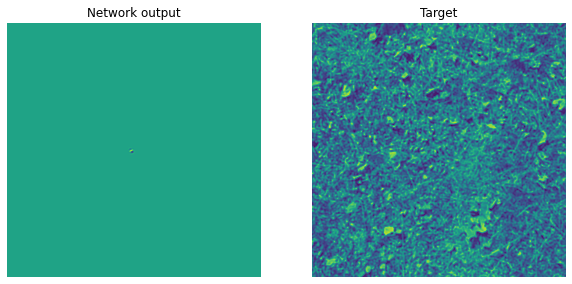

Training epoch 300, took 0.2788252830505371 s

Loss: 0.03888793
RMS deviance: 0.19720022
Learned Min: -0.92167103
Learned RMS: 0.48345545
Learned Max: 0.91650254


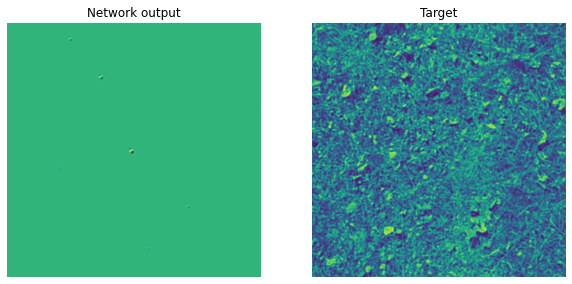

Training epoch 400, took 0.3119232654571533 s

Loss: 0.034919005
RMS deviance: 0.18686627
Learned Min: -0.92821294
Learned RMS: 0.48258936
Learned Max: 0.9017959


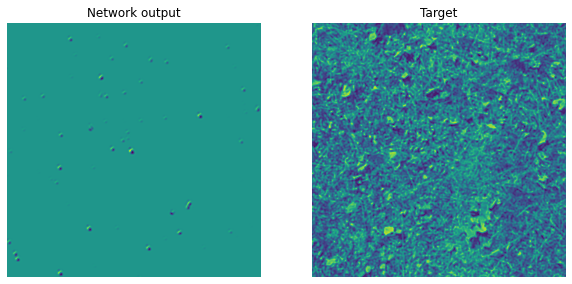

Training epoch 500, took 0.30439019203186035 s

Loss: 0.03399664
RMS deviance: 0.18438178
Learned Min: -0.93208027
Learned RMS: 0.48167992
Learned Max: 0.8880218


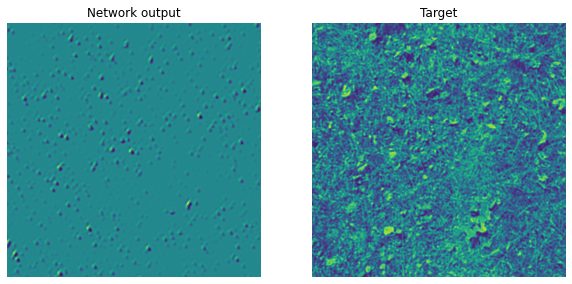

Training epoch 600, took 0.28507089614868164 s

Loss: 0.031413965
RMS deviance: 0.17723985
Learned Min: -0.9455219
Learned RMS: 0.47802347
Learned Max: 0.90257525


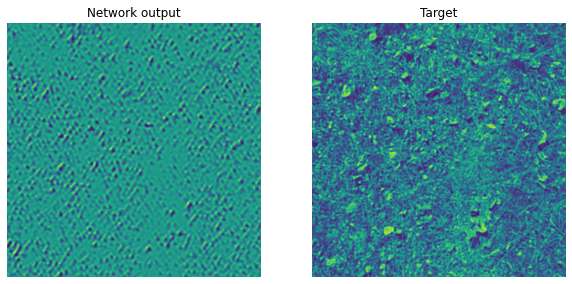

Training epoch 700, took 0.3031468391418457 s

Loss: 0.025662458
RMS deviance: 0.16019507
Learned Min: -0.95662093
Learned RMS: 0.4691557
Learned Max: 0.93248063


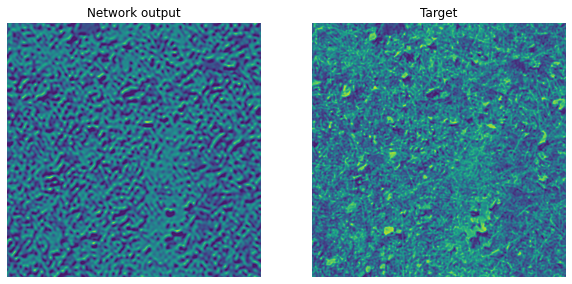

Training epoch 800, took 0.40697669982910156 s

Loss: 0.016573675
RMS deviance: 0.12873879
Learned Min: -0.9559849
Learned RMS: 0.46206924
Learned Max: 0.99900097


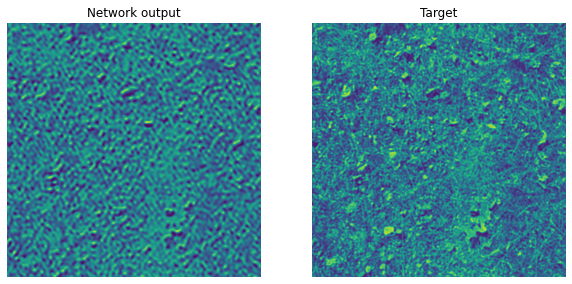

Training epoch 900, took 0.30691051483154297 s

Loss: 0.013142981
RMS deviance: 0.114642836
Learned Min: -0.95927525
Learned RMS: 0.4593651
Learned Max: 1.0436778


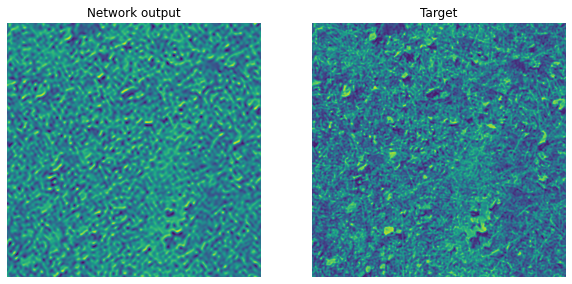

Training epoch 1000, took 0.2853705883026123 s

Loss: 0.010774802
RMS deviance: 0.10380174
Learned Min: -0.9631802
Learned RMS: 0.4582719
Learned Max: 1.096664


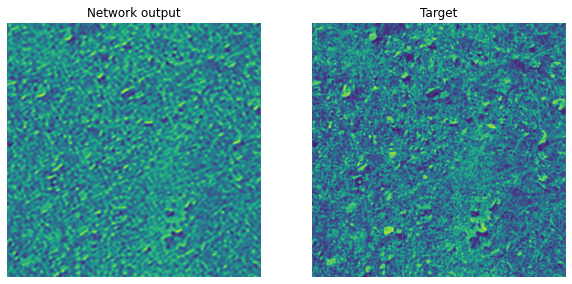

Training epoch 1100, took 0.4583170413970947 s

Loss: 0.009240301
RMS deviance: 0.09612649
Learned Min: -0.9683567
Learned RMS: 0.45894933
Learned Max: 1.1422511


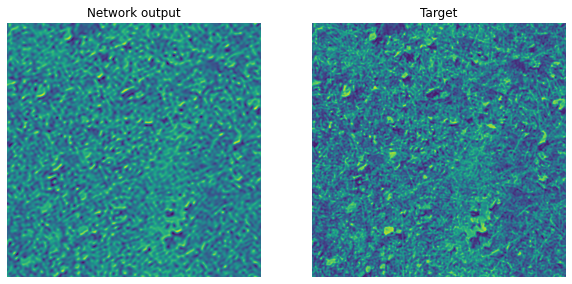

Training epoch 1200, took 0.32767796516418457 s

Loss: 0.008503887
RMS deviance: 0.09221652
Learned Min: -0.9706921
Learned RMS: 0.45858476
Learned Max: 1.1761737


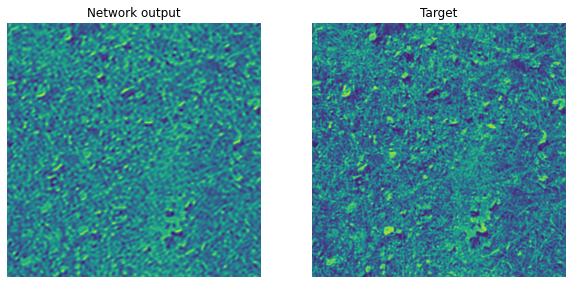

Training epoch 1300, took 0.32852721214294434 s

Loss: 0.007964935
RMS deviance: 0.08924649
Learned Min: -0.972285
Learned RMS: 0.4583414
Learned Max: 1.2005538


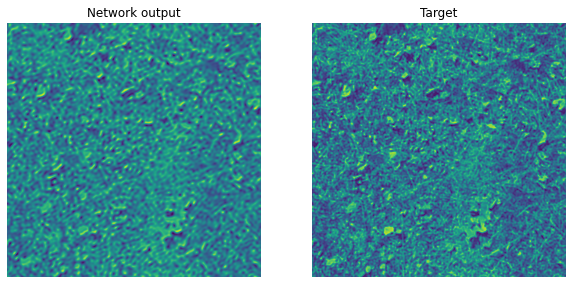

Training epoch 1400, took 0.3395237922668457 s

Loss: 0.0075374246
RMS deviance: 0.086818345
Learned Min: -0.9738451
Learned RMS: 0.4583518
Learned Max: 1.2206734


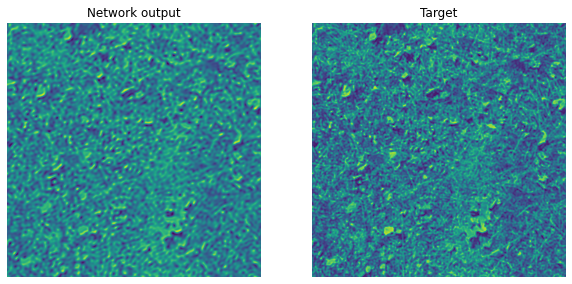

Training epoch 1500, took 0.3282144069671631 s

Loss: 0.007206213
RMS deviance: 0.08488942
Learned Min: -0.9753126
Learned RMS: 0.45841122
Learned Max: 1.2358801


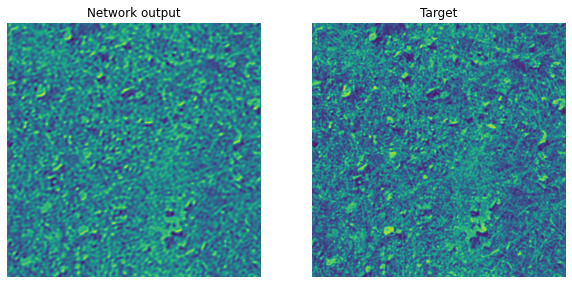

Training epoch 1600, took 0.2892725467681885 s

Loss: 0.006961163
RMS deviance: 0.08343358
Learned Min: -0.9766322
Learned RMS: 0.45838717
Learned Max: 1.2462795


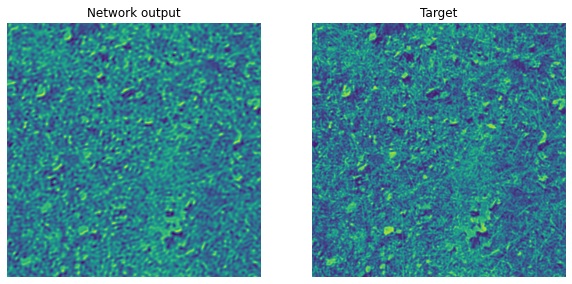

Training epoch 1700, took 0.3022143840789795 s

Loss: 0.006770088
RMS deviance: 0.08228055
Learned Min: -0.97776747
Learned RMS: 0.45828918
Learned Max: 1.2527384


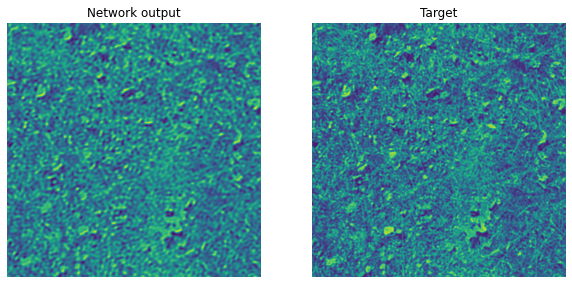

Training epoch 1800, took 0.3357374668121338 s

Loss: 0.006618984
RMS deviance: 0.08135714
Learned Min: -0.9787445
Learned RMS: 0.45824516
Learned Max: 1.256601


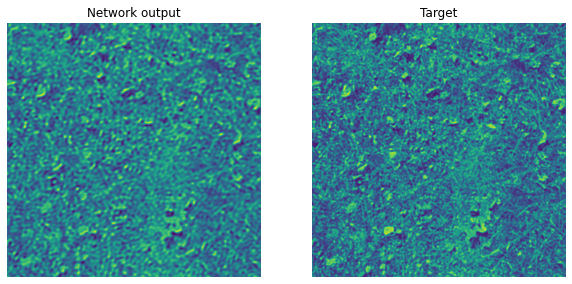

Training epoch 1900, took 0.2948629856109619 s

Loss: 0.0065025357
RMS deviance: 0.080638304
Learned Min: -0.9796584
Learned RMS: 0.45823592
Learned Max: 1.2582545


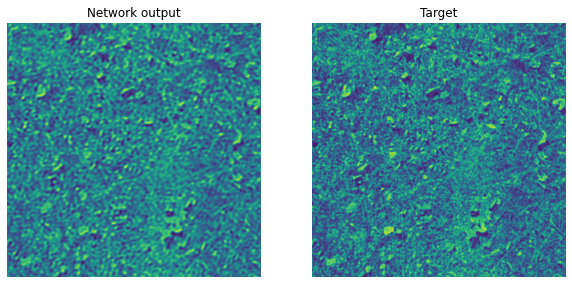

Training epoch 2000, took 0.28846168518066406 s

Loss: 0.006412855
RMS deviance: 0.0800803
Learned Min: -0.9804105
Learned RMS: 0.4582606
Learned Max: 1.2587334


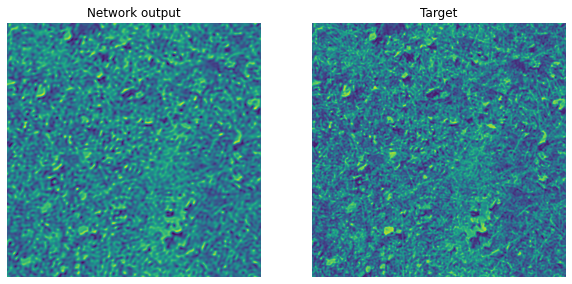

Training epoch 2100, took 0.30063891410827637 s

Loss: 0.006340866
RMS deviance: 0.079629555
Learned Min: -0.9812379
Learned RMS: 0.45831048
Learned Max: 1.2587857


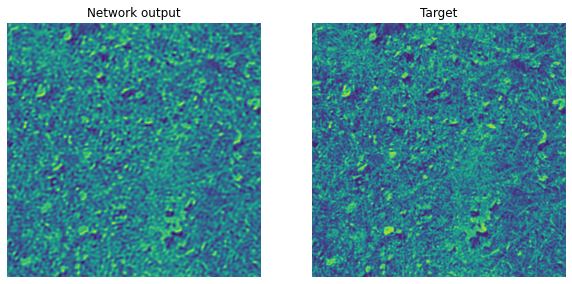

Training epoch 2200, took 0.30138063430786133 s

Loss: 0.006280297
RMS deviance: 0.079248324
Learned Min: -0.98210317
Learned RMS: 0.4583606
Learned Max: 1.2585346


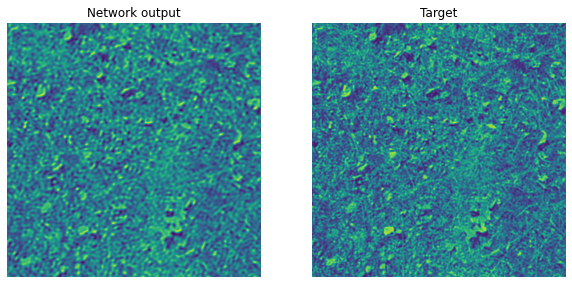

Training epoch 2300, took 0.2836458683013916 s

Loss: 0.0062305303
RMS deviance: 0.07893371
Learned Min: -0.9828824
Learned RMS: 0.45841274
Learned Max: 1.2582544


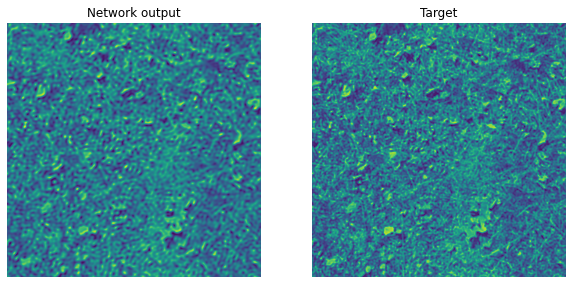

Training epoch 2400, took 0.30060529708862305 s

Loss: 0.00618175
RMS deviance: 0.07862411
Learned Min: -0.98346126
Learned RMS: 0.45846742
Learned Max: 1.2578883


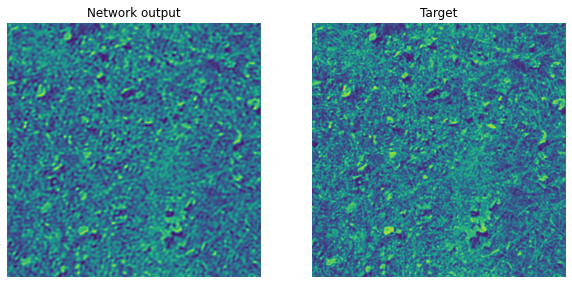

Training epoch 2500, took 0.30195116996765137 s

Loss: 0.0061402805
RMS deviance: 0.07835994
Learned Min: -0.98400027
Learned RMS: 0.4585282
Learned Max: 1.2577882


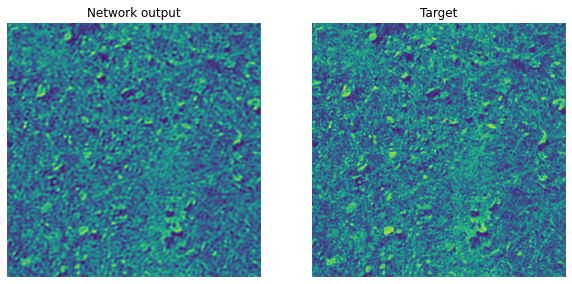

Training epoch 2600, took 0.316817045211792 s

Loss: 0.0061001214
RMS deviance: 0.078103274
Learned Min: -0.98451674
Learned RMS: 0.45859882
Learned Max: 1.257731


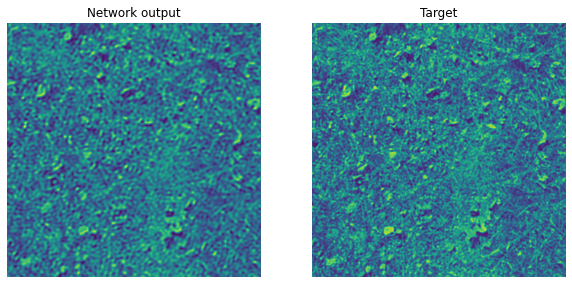

Training epoch 2700, took 0.30226778984069824 s

Loss: 0.0060657365
RMS deviance: 0.07788284
Learned Min: -0.9850267
Learned RMS: 0.4586709
Learned Max: 1.2578354


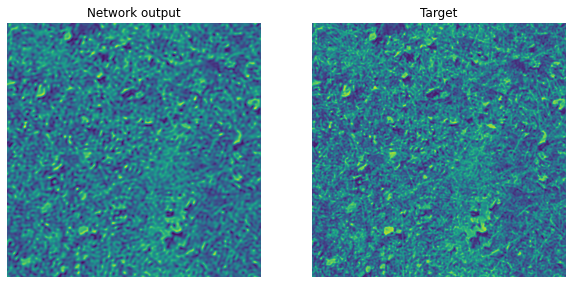

Training epoch 2800, took 0.34314417839050293 s

Loss: 0.0060313107
RMS deviance: 0.077661514
Learned Min: -0.9854122
Learned RMS: 0.45875528
Learned Max: 1.258224


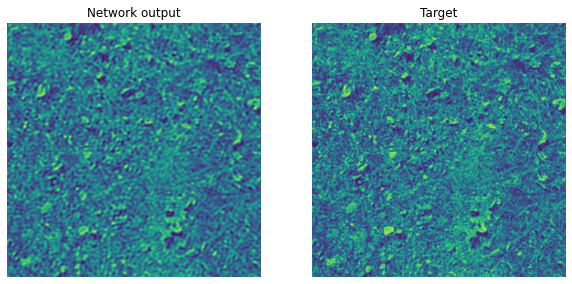

Training epoch 2900, took 0.3221144676208496 s

Loss: 0.0060001565
RMS deviance: 0.07746068
Learned Min: -0.98576105
Learned RMS: 0.45884234
Learned Max: 1.2586223


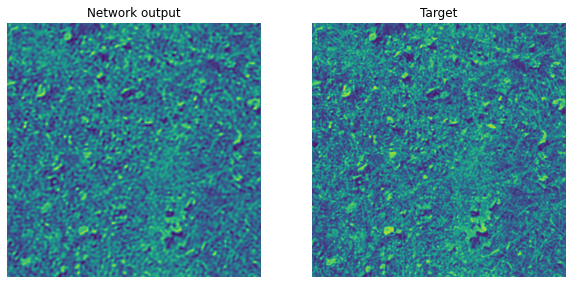

Training epoch 3000, took 0.31177330017089844 s

Loss: 0.0059708296
RMS deviance: 0.07727114
Learned Min: -0.986103
Learned RMS: 0.4589323
Learned Max: 1.259084


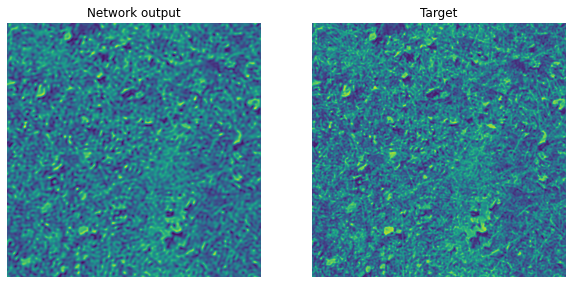

Training epoch 3100, took 0.31592321395874023 s

Loss: 0.0059435503
RMS deviance: 0.07709442
Learned Min: -0.9864345
Learned RMS: 0.4590221
Learned Max: 1.2595999


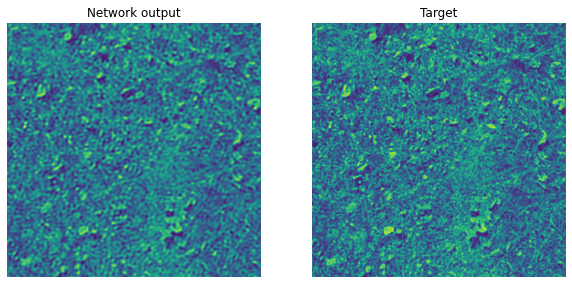

Training epoch 3200, took 0.3163022994995117 s

Loss: 0.0059180986
RMS deviance: 0.07692918
Learned Min: -0.98675627
Learned RMS: 0.45910957
Learned Max: 1.2601155


KeyboardInterrupt: 

In [23]:
EPOCHS = 10000
fit(EPOCHS)

In [14]:
print("learned_conv_1 weights and biases:\n")
print(model.get_layer('learned_conv_1').get_weights())
print("\nlearned_conv_2 weights and biases:\n")
print(model.get_layer('learned_conv_2').get_weights())

learned_conv_1 weights and biases:

[array([[[[-0.94973624, -0.9030416 ]],

        [[ 0.48296693,  0.40872353]],

        [[ 0.08086881, -0.4688723 ]],

        [[ 0.15249838,  0.22300981]]],


       [[[ 0.60749876,  0.1276281 ]],

        [[-0.3970263 , -0.59688437]],

        [[-0.54838204,  0.49983656]],

        [[ 0.49287933,  0.25426695]]],


       [[[ 0.13116203,  0.0097908 ]],

        [[ 1.1091605 , -0.78350705]],

        [[-0.80248576, -0.30360037]],

        [[-0.5613746 ,  0.35239384]]],


       [[[ 0.80437833,  0.79768115]],

        [[ 0.17592831,  0.09591913]],

        [[ 0.29907745, -1.0233442 ]],

        [[ 0.69078827,  0.96165335]]]], dtype=float32), array([-0.08318789,  0.07589049], dtype=float32)]

learned_conv_2 weights and biases:

[array([[[[ 0.24661964,  0.06856785],
         [-0.31802264, -0.9636979 ]],

        [[-0.18052517,  0.7896716 ],
         [-0.8330658 , -0.00529913]],

        [[ 1.0381749 , -0.6085476 ],
         [ 0.9913018 ,  0.72856635]],



In [12]:
def load_ckpt(latest = True, number = 1):
  if latest:
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
  else:
    checkpoint.restore('training_checkpoints_downup/ckpt-' + str(number))

# load_ckpt(False, 46)